<h1 align=center><font size = 5>Capstone Project - The Battle of Neighborhoods</font></h1>

The objective of this project is to find the most suitable location to establish a cafe/coffee shop in Bangalore, India

In [1]:
pip install geopandas

     |████████████████████████████████| 972kB 12.1MB/s eta 0:00:01
     |████████████████████████████████| 10.9MB 1.2MB/s  eta 0:00:01    |██████▊                         | 2.3MB 20.0MB/s eta 0:00:01
     |████████████████████████████████| 1.8MB 32.0MB/s eta 0:00:01
     |████████████████████████████████| 14.7MB 36.9MB/s eta 0:00:01    |█▉                              | 839kB 10.4MB/s eta 0:00:02     |██████████████████▉             | 8.6MB 10.4MB/s eta 0:00:01
  Using cached https://files.pythonhosted.org/packages/d2/3d/fa76db83bf75c4f8d338c2fd15c8d33fdd7ad23a9b5e57eb6c5de26b430e/click-7.1.2-py2.py3-none-any.whl
  Found existing installation: pyproj 1.9.6
    Uninstalling pyproj-1.9.6:
      Successfully uninstalled pyproj-1.9.6
Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install geopy

     |████████████████████████████████| 112kB 5.4MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [3]:
#importing necessary libraries
import requests
import pandas as pd
import geopandas as gpd
import numpy as np
from geopy.geocoders import Nominatim
import folium # map rendering library
from sklearn.cluster import KMeans 

In [4]:
#Bengaluru neighbourhoods/wards information is available from the BBMP site
blr_df= gpd.read_file('/resources/labs/DP0701EN/BBMP.GeoJSON')
blr_df.to_csv(r'/resources/labs/DP0701EN/blr_json.csv', index = False)
blr_df.shape

(198, 15)

In [5]:
#Retrieve the lat and long for Bangalore
address = 'Bangalore, IN'
geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Bangalore are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Bangalore are 12.9791198, 77.5912997.


In [6]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

map_blore.save('/resources/labs/DP0701EN/blr_pop.html')
map_blore

In [7]:
CLIENT_ID = '5JFEUYYWAEV54YT0KP2ESZM24MLE5RDHLD0RNORZXQUTANI5' # your Foursquare ID
CLIENT_SECRET = '2IIXNUBF0N4FKEBBM20RYBM4VAB1F1BM2QRHFESRIJO0RTVB' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 5JFEUYYWAEV54YT0KP2ESZM24MLE5RDHLD0RNORZXQUTANI5
CLIENT_SECRET:2IIXNUBF0N4FKEBBM20RYBM4VAB1F1BM2QRHFESRIJO0RTVB


In [8]:
# function to retrieve all venues for all neighborhoods in Bangalore
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [9]:
 blr_venues = getNearbyVenues(names=blr_df['WARD_NAME'],
                                  latitudes=blr_df['LAT'],
                                   longitudes=blr_df['LON']
                                 )

In [10]:
#blr_venues.to_csv(r'/resources/labs/DP0701EN/blr_venues.csv', index = False)
blr_venues = pd.read_csv("/resources/labs/DP0701EN/blr_venues.csv")

Determine the number of unique venues in Bangalore location

In [11]:
#No of venues
print(blr_venues.shape)
blr_venues.head()

(1273, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Chowdeswari Ward,13.121709,77.580422,Nite Mart,13.122206,77.576290,Department Store
1,Atturu,13.102805,77.560038,Axis Bank ATM,13.102350,77.560310,ATM
2,Atturu,13.102805,77.560038,LG Brand Shop,13.102462,77.559921,Electronics Store
3,Yelahanka Satellite Town,13.090987,77.583925,Kanti Sweets,13.093498,77.582429,Dessert Shop
4,Yelahanka Satellite Town,13.090987,77.583925,Vishwa Bakery,13.089937,77.583161,Café


In [12]:
#print out the list of categories
blr_venues['Venue Category'].nunique()
#blr_venues.describe

186

Identify the number of cafes or coffee shops that exist in Bangalore 

In [13]:
blr_cafe = blr_venues[blr_venues['Venue Category']=='Café']
blr_cafe.shape

(89, 7)

In [14]:
blr_coffee_shop = blr_venues[blr_venues['Venue Category']=='Coffee Shop']
blr_coffee_shop.shape

(33, 7)

In [29]:
#Create a single dataframe consisting of cafes and coffee shops
frames = [blr_cafe,blr_coffee_shop]
blr_cafe_all = pd.concat(frames).reset_index()
blr_cafe_all.to_csv(r'/resources/labs/DP0701EN/blr_cafes.csv', index = False)
blr_cafe_all.head()

,index,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,4,Yelahanka Satellite Town,13.090987,77.583925,Vishwa Bakery,13.089937,77.583161,Café
1,11,Hudi,13.022376,77.705493,Cafe Coffee Day,13.020088,77.709071,Café
2,33,Kengeri,12.915069,77.477528,Cafe Coffee Day,12.915288,77.481766,Café
3,39,Rajarajeshwari Nagar,12.918757,77.522142,Kaapi Katte,12.916458,77.520567,Café
4,40,Rajarajeshwari Nagar,12.918757,77.522142,Cafe Coffee Day,12.920846,77.520570,Café


Let's place these cafes on the Bangalore map

In [16]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)
# add cafes as markers
for lat, lng, label in zip(blr_cafe_all['Venue Latitude'], blr_cafe_all['Venue Longitude'], blr_cafe_all['Venue']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='red',
        fill=True,
        fill_color='yellow',
        fill_opacity=0.5,
        parse_html=False).add_to(map_blore)  
map_blore.save('/resources/labs/DP0701EN/blr_all_cafes.html')
map_blore

In [17]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# add cafes as markers
for lat, lng, label in zip(blr_cafe_all['Venue Latitude'], blr_cafe_all['Venue Longitude'], blr_cafe_all['Venue']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='red',
        fill=True,
        fill_color='yellow',
        fill_opacity=0.5,
        parse_html=False).add_to(map_blore)  
map_blore.save('/resources/labs/DP0701EN/blr_all_cafes_with_pop.html')
map_blore

In [18]:
#Calculating the number of cafes by ward
count_by_ward = blr_cafe_all.groupby(['Neighborhood','Neighborhood Latitude','Neighborhood Longitude'])['Venue Category'].count().reset_index()
count_by_ward
#no of cafes
#count_by_ward.sum(axis=0)
#wards with maximum no of cafes
count_by_ward.sort_values(by=['Venue Category'],inplace=True, ascending=False)
count_by_ward

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue Category
57,Shantala Nagar,12.969867,77.606464,11
37,Koramangala,12.931340,77.624649,9
14,Domlur,12.963361,77.638040,5
4,BTM Layout,12.911838,77.609345,4
26,Hoysala Nagar,12.978456,77.638783,4
...,...,...,...,...
1,Agrahara Dasarahalli,12.980497,77.541535,1
34,Kengeri,12.915069,77.477528,1
35,Konankunte,12.885775,77.579901,1
38,Kottegepalya,12.982456,77.514090,1


Text(0.5, 1.0, 'No of cafes per ward')

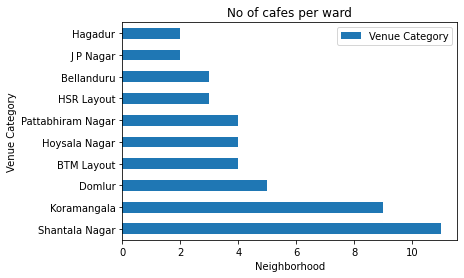

In [19]:
import matplotlib.pyplot as plt
#plot data
df_cafe_ward = count_by_ward[['Neighborhood','Venue Category']]
df_cafe_top10 = df_cafe_ward.head(10)
df_cafe_top10.plot.barh(x="Neighborhood")
plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Venue Category') # add y-label to the plot
plt.title('No of cafes per ward') # add title to the plot

We see Shantala Nagar and Koramangala have the maximum number of cafes in Bangalore city

In [20]:
#adding the count of cafes per ward
temp_blr_json = blr_df.copy()
temp_blr_json.rename(columns = {'WARD_NAME':'Neighborhood'}, inplace = True)
temp_cf_df = temp_blr_json.merge(df_cafe_ward, on='Neighborhood', how='left')
temp_cf_df.head(10)
temp_cf_df.rename(columns = {'Venue Category':'Cafe_Count'}, inplace = True) 
#if a ward has a cafe count of NaN we can assume there are no cafes in the location
temp_cf_df['Cafe_Count'] = temp_cf_df['Cafe_Count'].fillna(0)
temp_cf_df.head(3)

,OBJECTID,ASS_CONST_,ASS_CONST1,WARD_NO,Neighborhood,POP_M,POP_F,POP_SC,POP_ST,POP_TOTAL,AREA_SQ_KM,LAT,LON,RESERVATIO,geometry,Cafe_Count
0,1,150,Yelahanka,2.0,Chowdeswari Ward,10402.0,9224.0,2630.0,286.0,19626.0,7.06,13.121709,77.580422,General,"MULTIPOLYGON (((77.59229 13.09720, 77.59094 13...",0.0
1,2,150,Yelahanka,3.0,Atturu,13129.0,10891.0,2921.0,665.0,24020.0,10.15,13.102805,77.560038,General (Women),"MULTIPOLYGON (((77.56862 13.12705, 77.57064 13...",0.0
2,3,150,Yelahanka,4.0,Yelahanka Satellite Town,13457.0,12325.0,3687.0,601.0,25782.0,4.90,13.090987,77.583925,Backward Category - A,"MULTIPOLYGON (((77.59094 13.09842, 77.59229 13...",1.0


In [21]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Chrolopeth representing the number of cafes by ward
map_blore.choropleth(
 geo_data=temp_cf_df,
 name='choropleth',
 data=temp_cf_df,
 columns=['Neighborhood', 'Cafe_Count'],
 key_on='feature.properties.Neighborhood',
 fill_color='PuRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='No of Cafes'
)
folium.LayerControl().add_to(map_blore)
map_blore

We can see from the graph above that Shantala Nagar 
also popularly known as the MG Road area) and Koramangala have the maximum number of cafes, lets place them on the map

In [22]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# I can add marker one by one on the map
for i in range(0,len(count_by_ward)):
   folium.Circle(
      location=[float(count_by_ward.iloc[i]['Neighborhood Latitude']), float(count_by_ward.iloc[i]['Neighborhood Longitude'])],
      popup=count_by_ward.iloc[i]['Neighborhood'] + '-' + str(count_by_ward.iloc[i]['Venue Category']),
      radius=float(count_by_ward.iloc[i]['Venue Category'])*150,
      color='red',
      fill=True,
      fill_color='red'
   ).add_to(map_blore)
map_blore.save('/resources/labs/DP0701EN/blr_cafes_ward_wise.html')
map_blore

## Analyze Each Neighborhood/Ward in Bangalore

In [23]:
# one hot encoding
blr_onehot = pd.get_dummies(blr_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
blr_onehot['Neighborhood'] = blr_venues['Neighborhood'] 
#move neighbourhood to first position
col_name="Neighborhood"
first_col = blr_onehot.pop(col_name)
blr_onehot.insert(0,col_name, first_col)
blr_grouped = blr_onehot.groupby('Neighborhood').mean().reset_index()
blr_grouped

,Neighborhood,ATM,Afghan Restaurant,Airport,American Restaurant,Andhra Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,...,Thai Restaurant,Theater,Tibetan Restaurant,Trail,Train Station,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Women's Store,Yoga Studio
0,A Narayanapura,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Adugodi,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Agaram,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Agrahara Dasarahalli,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Anjanapura,0.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
166,Vishwanath Nagenahalli,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
167,Vrisabhavathi Nagar,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
168,Yediyur,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
169,Yelahanka Satellite Town,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [24]:
#function to sort the venues in descending order.
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [25]:
# Retrieve the top 10 venues in each ward
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = blr_grouped['Neighborhood']

for ind in np.arange(blr_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(blr_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,A Narayanapura,Movie Theater,Bus Stop,Fish Market,Electronics Store,Bus Station,Fast Food Restaurant,Farmers Market,Event Space,Eastern European Restaurant,Dumpling Restaurant
1,Adugodi,Indian Restaurant,Café,Yoga Studio,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
2,Agaram,Burger Joint,Yoga Studio,Dry Cleaner,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant
3,Agrahara Dasarahalli,Bagel Shop,Indian Restaurant,Garden,Café,Yoga Studio,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space
4,Anjanapura,ATM,Campground,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant


In [26]:
to_grouped = blr_onehot.groupby(["Neighborhood"]).mean().reset_index()
to_grouped.head()

,Neighborhood,ATM,Afghan Restaurant,Airport,American Restaurant,Andhra Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,...,Thai Restaurant,Theater,Tibetan Restaurant,Trail,Train Station,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Women's Store,Yoga Studio
0,A Narayanapura,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Adugodi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Agaram,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Agrahara Dasarahalli,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Anjanapura,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [27]:
#Create a new dataframe with neighborhood population and cafe count and these will serve as the variables for K means
cafe_df = temp_cf_df[['Neighborhood','POP_TOTAL','Cafe_Count']]
cafe_df

,Neighborhood,POP_TOTAL,Cafe_Count
0,Chowdeswari Ward,19626.0,0.0
1,Atturu,24020.0,0.0
2,Yelahanka Satellite Town,25782.0,1.0
3,Vijnanapura,35087.0,0.0
4,Basavanapura,22012.0,0.0
...,...,...,...
193,Madivala,35155.0,0.0
194,Ramamurthy Nagar,21999.0,0.0
195,Horamavu,28167.0,0.0
196,Marathahalli,22489.0,1.0


## Cluster Neighborhoods

Let’s arbitrarily assign the value of k as 5. We will implement k-means clustering using k=5

In [30]:
x= cafe_df.iloc[:, [1,2]].values
kmeans5 = KMeans(n_clusters=5)
y_kmeans5 = kmeans5.fit_predict(x)
print(y_kmeans5)
kmeans5.cluster_centers_

[3 1 1 0 3 3 3 2 1 4 3 1 3 3 4 3 3 3 1 3 3 2 3 0 0 2 1 1 2 2 1 2 1 2 1 2 2
 0 0 4 0 0 0 0 2 0 0 4 4 0 0 1 1 1 1 1 0 1 2 4 1 4 2 0 4 2 0 4 4 0 2 0 4 0
 2 4 2 0 0 0 0 4 4 1 0 4 0 1 2 0 0 0 0 0 0 4 0 4 4 0 0 0 1 1 0 4 0 0 4 0 1
 1 1 3 3 1 3 3 4 0 4 1 2 0 1 2 0 4 4 1 2 4 0 4 4 0 0 4 0 0 0 0 0 0 0 0 3 3
 2 0 4 0 1 2 2 2 0 0 1 1 0 2 2 3 1 3 3 3 1 3 1 1 3 3 3 3 1 3 1 3 2 3 3 3 3
 3 1 1 2 0 1 1 2 0 3 2 3 1]


array([[3.54543333e+04, 8.00000000e-01],
       [2.55169762e+04, 5.00000000e-01],
       [2.95396667e+04, 1.03333333e+00],
       [2.14618378e+04, 2.97297297e-01],
       [3.31346207e+04, 3.79310345e-01]])

Using Elbow method to find the optimal number of clusters in a dataset. 

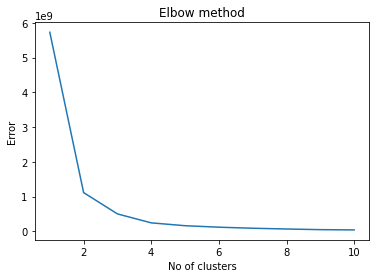

In [31]:
Error =[]
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i).fit(x)
    kmeans.fit(x)
    Error.append(kmeans.inertia_)
import matplotlib.pyplot as plt
plt.plot(range(1, 11), Error)
plt.title('Elbow method')
plt.xlabel('No of clusters')
plt.ylabel('Error')
plt.show()

Note that the shape of elbow is approximately formed at k=4.

In [32]:
# set number of clusters
toclusters = 4
to_clustering = cafe_df.drop(["Neighborhood"], 1)
# run k-means clustering
kmeans = KMeans(n_clusters=toclusters, random_state=0).fit(to_clustering)
# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:20]

array([0, 3, 3, 1, 0, 0, 0, 2, 3, 1, 0, 3, 0, 0, 2, 0, 0, 0, 3, 0],
      dtype=int32)

In [33]:
# create a new dataframe that includes the cluster as well as the labels and neighborhoods
to_merged = cafe_df.copy()
# add clustering labels
to_merged["Cluster Labels"] = kmeans.labels_
to_merged.rename(columns={"Neighborhoods": "Neighborhood"}, inplace=True)
tmp1_df = temp_cf_df[['Neighborhood', 'LAT', 'LON']]
to_merged = pd.merge(to_merged,tmp1_df, on='Neighborhood')
to_merged

,Neighborhood,POP_TOTAL,Cafe_Count,Cluster Labels,LAT,LON
0,Chowdeswari Ward,19626.0,0.0,0,13.121709,77.580422
1,Atturu,24020.0,0.0,3,13.102805,77.560038
2,Yelahanka Satellite Town,25782.0,1.0,3,13.090987,77.583925
3,Vijnanapura,35087.0,0.0,1,13.006063,77.669565
4,Basavanapura,22012.0,0.0,0,13.016847,77.715456
...,...,...,...,...,...,...
193,Madivala,35155.0,0.0,1,12.920018,77.614418
194,Ramamurthy Nagar,21999.0,0.0,0,13.033613,77.676539
195,Horamavu,28167.0,0.0,2,13.044561,77.653271
196,Marathahalli,22489.0,1.0,0,12.950743,77.691495


In [34]:
# merge blr_grouped with blr_data to add latitude/longitude for each neighborhood
to_merged = to_merged.join(blr_venues.set_index("Neighborhood"), on="Neighborhood")
print(to_merged.shape)
to_merged.head()

(1300, 12)


,Neighborhood,POP_TOTAL,Cafe_Count,Cluster Labels,LAT,LON,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Chowdeswari Ward,19626.0,0.0,0,13.121709,77.580422,13.121709,77.580422,Nite Mart,13.122206,77.576290,Department Store
1,Atturu,24020.0,0.0,3,13.102805,77.560038,13.102805,77.560038,Axis Bank ATM,13.102350,77.560310,ATM
1,Atturu,24020.0,0.0,3,13.102805,77.560038,13.102805,77.560038,LG Brand Shop,13.102462,77.559921,Electronics Store
2,Yelahanka Satellite Town,25782.0,1.0,3,13.090987,77.583925,13.090987,77.583925,Kanti Sweets,13.093498,77.582429,Dessert Shop
2,Yelahanka Satellite Town,25782.0,1.0,3,13.090987,77.583925,13.090987,77.583925,Vishwa Bakery,13.089937,77.583161,Café


In [35]:
# sort the results by Cluster Labels
print(to_merged.shape)
to_merged.sort_values(["Cluster Labels"], inplace=True)
to_merged

(1300, 12)


,Neighborhood,POP_TOTAL,Cafe_Count,Cluster Labels,LAT,LON,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Chowdeswari Ward,19626.0,0.0,0,13.121709,77.580422,13.121709,77.580422,Nite Mart,13.122206,77.576290,Department Store
113,Marenahalli,20068.0,0.0,0,12.971889,77.532844,12.971889,77.532844,Prashanth Nagar,12.976342,77.532330,Bus Station
114,Maruthi Mandir ward,21784.0,0.0,0,12.966711,77.528464,12.966711,77.528464,KFC,12.963904,77.528428,American Restaurant
114,Maruthi Mandir ward,21784.0,0.0,0,12.966711,77.528464,12.966711,77.528464,State Bank of India ATM,12.967359,77.528766,ATM
114,Maruthi Mandir ward,21784.0,0.0,0,12.966711,77.528464,12.966711,77.528464,The Fitt Club,12.964886,77.528238,Gym
...,...,...,...,...,...,...,...,...,...,...,...,...
83,Jayamahal,24065.0,1.0,3,12.995107,77.599931,12.995107,77.599931,Cafe Coffee Day,12.995117,77.603028,Café
83,Jayamahal,24065.0,1.0,3,12.995107,77.599931,12.995107,77.599931,Jayamahal Palace,12.996887,77.597217,Event Space
83,Jayamahal,24065.0,1.0,3,12.995107,77.599931,12.995107,77.599931,Pai Vihar,12.993172,77.595887,Indian Restaurant
159,Jakkasandra,24088.0,0.0,3,12.920591,77.630989,12.920591,77.630989,Kerala Mess,12.921728,77.633888,Indian Restaurant


Let's visualize the resulting clusters

In [36]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# set color scheme for the clusters
x = np.arange(toclusters)
ys = [i+x+(i*x)**2 for i in range(toclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

colordict = {-1: 'purple', 0: 'blue', 1: 'orange', 2: 'red', 3: 'pink'}
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(to_merged['LAT'], to_merged['LON'], to_merged['Neighborhood'], to_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' - Cluster ' + str(cluster))
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=colordict[cluster-1],
        fill_color=colordict[cluster-1], fill=True,
        fill_opacity=1).add_to(map_blore)
map_blore.save('/resources/labs/DP0701EN/blr_cafe_segments2.html')       
map_blore

We observe that the clusters are concentric in nature and moves away from the heart of the city.

## Examine Clusters

#### Cluster 1

Let's view the most common or popular venues in first cluster by neighborhood

In [37]:
fullcluster0 = to_merged.loc[to_merged['Cluster Labels'] == 0].copy()
clustertemp0 = fullcluster0[["Neighborhood", "Cluster Labels"]].copy()
clustertemp0.drop_duplicates(inplace=True) 
cluster0 = pd.merge(clustertemp0,neighborhoods_venues_sorted, on='Neighborhood')
cluster0

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Chowdeswari Ward,0,Department Store,Yoga Studio,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant
1,Marenahalli,0,Indian Restaurant,Food Truck,Arts & Crafts Store,Bus Station,Yoga Studio,Dumpling Restaurant,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market
2,Maruthi Mandir ward,0,ATM,American Restaurant,Snack Place,Gym,Pharmacy,Dog Run,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
3,Nayandahalli,0,Southern / Soul Food Restaurant,Yoga Studio,Food,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant
4,Shakambari Nagar,0,Hookah Bar,Women's Store,Metro Station,Jewelry Store,Dry Cleaner,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
5,Bellanduru,0,Café,Tea Room,Bakery,Coffee Shop,Restaurant,Business Service,Sandwich Place,Juice Bar,Yoga Studio,Fast Food Restaurant
6,Garudachar Playa,0,Soccer Field,Athletics & Sports,Yoga Studio,Dry Cleaner,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
7,Dodda Nekkundi,0,Coffee Shop,Ice Cream Shop,Indian Restaurant,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
8,Ganesh Mandir ward,0,Fast Food Restaurant,Snack Place,Pizza Place,Indian Restaurant,Café,Department Store,Shopping Mall,Asian Restaurant,Pub,Indian Chinese Restaurant
9,Bilekhalli,0,Pharmacy,Department Store,Bakery,Yoga Studio,Dry Cleaner,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space


In [38]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster0['LAT'], fullcluster0['LON'], fullcluster0['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='purple',
        fill=True,
        fill_color='purple',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

In [39]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Chrolopeth representing the number of cafes by ward
map_blore.choropleth(
 geo_data=temp_cf_df,
 name='choropleth',
 data=temp_cf_df,
 columns=['Neighborhood', 'Cafe_Count'],
 key_on='feature.properties.Neighborhood',
 fill_color='PuRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='No of Cafes'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 locations as markers
for lat, lng, label in zip(fullcluster0['LAT'], fullcluster0['LON'], fullcluster0['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='green',
        fill=True,
        fill_color='green',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

We observe that cafes are not the most popular venues in the neighborhoods in the cluster 
which is good news from a competitiion perspective, but location wise we see that these locations lie on the out skirts 
of Bangalore with less dense population, which is not great for business, we are looking for locations more closer to the popular locations

#### Cluster 2

In [40]:
fullcluster1 = to_merged.loc[to_merged['Cluster Labels'] == 1].copy()
clustertemp1 = fullcluster1[["Neighborhood", "Cluster Labels"]].copy()
clustertemp1.drop_duplicates(inplace=True) 
cluster1 = pd.merge(clustertemp1,neighborhoods_venues_sorted, on='Neighborhood')
cluster1

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Azad Nagar,1,Shopping Mall,Fast Food Restaurant,Café,Multiplex,Donut Shop,Fish Market,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant
1,Rajaji Nagar,1,Indian Restaurant,Park,Chinese Restaurant,Clothing Store,Café,Burger Joint,Fast Food Restaurant,Bakery,Seafood Restaurant,Grocery Store
2,Dharmaraya Swamy Temple,1,Theater,Market,Food Truck,South Indian Restaurant,Yoga Studio,Donut Shop,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
3,Sunkenahalli,1,Indian Restaurant,Coffee Shop,Fast Food Restaurant,Ice Cream Shop,Juice Bar,Department Store,Pizza Place,Sandwich Place,Bakery,Yoga Studio
4,Prakash Nagar,1,Café,Motorcycle Shop,Bakery,Yoga Studio,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
...,...,...,...,...,...,...,...,...,...,...,...,...
72,Vijnanapura,1,ATM,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant,Dumpling Restaurant
73,J P Park,1,Park,ATM,Chinese Restaurant,Donut Shop,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant
74,Yeshwanthpura,1,Fast Food Restaurant,Yoga Studio,Donut Shop,Flea Market,Fish Market,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant,Dumpling Restaurant
75,Vrisabhavathi Nagar,1,Hotel,Home Service,ATM,Vegetarian / Vegan Restaurant,Flower Shop,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store


In [41]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster1['LAT'], fullcluster1['LON'], fullcluster1['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

In [42]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Chrolopeth representing the number of cafes by ward
map_blore.choropleth(
 geo_data=temp_cf_df,
 name='choropleth',
 data=temp_cf_df,
 columns=['Neighborhood', 'Cafe_Count'],
 key_on='feature.properties.Neighborhood',
 fill_color='PuRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='No of Cafes'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster1['LAT'], fullcluster1['LON'], fullcluster1['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

We observe that this cluster of locations are in the densely populated areas and 
around the areas with existing cafe venues. We also notice Koramangala one of the areas with highest number of cafes
exist in this cluster. We can choose to exclude this location. 
These locations are the best fit if we looking for busy and happening downtown spots with high foot fall.

#### Cluster 3

In [43]:
fullcluster2 = to_merged.loc[to_merged['Cluster Labels'] == 2].copy()
clustertemp2 = fullcluster2[["Neighborhood", "Cluster Labels"]].copy()
clustertemp2.drop_duplicates(inplace=True) 
cluster2 = pd.merge(clustertemp2,neighborhoods_venues_sorted, on='Neighborhood')
cluster2

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Byatarayanapura,2,Print Shop,Restaurant,Indian Restaurant,Dog Run,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant,Dumpling Restaurant
1,Karisandra,2,Ice Cream Shop,Indian Restaurant,Italian Restaurant,Diner,Restaurant,Gym,Snack Place,South Indian Restaurant,Salad Place,Dry Cleaner
2,Jalahalli,2,Soccer Field,Basketball Court,Yoga Studio,Food,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
3,Jayanagar East,2,Indian Restaurant,Asian Restaurant,Chinese Restaurant,Radio Station,Yoga Studio,Donut Shop,Fish Market,Fast Food Restaurant,Farmers Market,Event Space
4,HMT Ward,2,Coffee Shop,Fast Food Restaurant,Train Station,Indian Restaurant,Department Store,Donut Shop,Fish Market,Farmers Market,Event Space,Electronics Store
5,Kottegepalya,2,Breakfast Spot,Indian Restaurant,Café,Yoga Studio,Dry Cleaner,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space
6,J P Nagar,2,Indian Restaurant,Café,Fast Food Restaurant,Snack Place,South Indian Restaurant,Diner,Yoga Studio,Dry Cleaner,Fish Market,Farmers Market
7,A Narayanapura,2,Movie Theater,Bus Stop,Fish Market,Electronics Store,Bus Station,Fast Food Restaurant,Farmers Market,Event Space,Eastern European Restaurant,Dumpling Restaurant
8,Jayachamarajendra Nagar,2,Indian Restaurant,Hotel,Pizza Place,Fast Food Restaurant,Bistro,Movie Theater,Park,Vegetarian / Vegan Restaurant,Dance Studio,Dry Cleaner
9,Muneshwara Nagar,2,ATM,Food Truck,Donut Shop,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant,Dumpling Restaurant


In [44]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster2['LAT'], fullcluster2['LON'], fullcluster2['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='magenta',
        fill=True,
        fill_color='magenta',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

In [45]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Chrolopeth representing the number of cafes by ward
map_blore.choropleth(
 geo_data=temp_cf_df,
 name='choropleth',
 data=temp_cf_df,
 columns=['Neighborhood', 'Cafe_Count'],
 key_on='feature.properties.Neighborhood',
 fill_color='PuRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='No of Cafes'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster2['LAT'], fullcluster2['LON'], fullcluster2['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='magenta',
        fill=True,
        fill_color='magenta',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

This cluster encompasses the suburban areas of Bangalore away from the heart of the city but not too far on the outskirts. This cluster also includes MG Road which can be excluded as it is the neighborhood with the highest
number of cafes and hence more competition. If one is looking to estbalish a cafe in a laid back set up with less dense 
population, this cluster of locations would be the most appropriate.

#### Cluster 4

In [46]:
fullcluster3 = to_merged.loc[to_merged['Cluster Labels'] == 3].copy()
clustertemp3 = fullcluster3[["Neighborhood", "Cluster Labels"]].copy()
clustertemp3.drop_duplicates(inplace=True) 
cluster3 = pd.merge(clustertemp3,neighborhoods_venues_sorted, on='Neighborhood')
cluster3

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,HSR Layout,3,Indian Restaurant,Café,Department Store,Gym / Fitness Center,Snack Place,Food Court,Restaurant,Badminton Court,Pizza Place,Kebab Restaurant
1,Hagadur,3,Café,Brewery,Bakery,Restaurant,Kerala Restaurant,Eastern European Restaurant,Hotel,Hotel Bar,Ice Cream Shop,Department Store
2,Gangenahalli,3,Indian Restaurant,Hotel,Vegetarian / Vegan Restaurant,Fast Food Restaurant,Pizza Place,Dog Run,Fish Market,Farmers Market,Event Space,Electronics Store
3,T Dasarahalli,3,Indian Restaurant,Metro Station,Resort,Karnataka Restaurant,Indian Sweet Shop,Yoga Studio,Dry Cleaner,Fast Food Restaurant,Farmers Market,Event Space
4,Mallasandra,3,ATM,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant,Dumpling Restaurant
5,Arakere,3,ATM,Dog Run,Badminton Court,Dry Cleaner,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
6,Bommanahalli,3,Indian Restaurant,Hotel,South Indian Restaurant,Department Store,Donut Shop,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store
7,Vasanthpura,3,Indian Restaurant,Boarding House,Tennis Court,Dry Cleaner,Flower Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space
8,Vasanth Nagar,3,Hotel,Lounge,Golf Course,Indian Restaurant,Nightclub,Café,Restaurant,Japanese Restaurant,Italian Restaurant,Coffee Shop
9,Kuvempu Nagar,3,Outdoors & Recreation,Donut Shop,Flea Market,Fish Market,Fast Food Restaurant,Farmers Market,Event Space,Electronics Store,Eastern European Restaurant,Dumpling Restaurant


In [47]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Add the color for the chloropleth by population of each ward:
map_blore.choropleth(
 geo_data=blr_df,
 name='choropleth',
 data=blr_df,
 columns=['WARD_NAME', 'POP_TOTAL'],
 key_on='feature.properties.WARD_NAME',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population (%)'
)
folium.LayerControl().add_to(map_blore)

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster3['LAT'], fullcluster3['LON'], fullcluster3['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='magenta',
        fill=True,
        fill_color='magenta',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

In [48]:
# create map of Bangalore using latitude and longitude values
map_blore = folium.Map(location=[latitude, longitude], zoom_start=11)

# Chrolopeth representing the number of cafes by ward
map_blore.choropleth(
 geo_data=temp_cf_df,
 name='choropleth',
 data=temp_cf_df,
 columns=['Neighborhood', 'Cafe_Count'],
 key_on='feature.properties.Neighborhood',
 fill_color='PuRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='No of Cafes'
)
folium.LayerControl().add_to(map_blore)
map_blore

# add cluster 0 cafes as markers
for lat, lng, label in zip(fullcluster3['LAT'], fullcluster3['LON'], fullcluster3['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=1,
        parse_html=False).add_to(map_blore)  
map_blore

This cluster represents the fast growing neighborhoods 